In [1]:
from IPython.display import HTML
HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
The raw code for this IPython notebook is by default hidden for easier reading.
To toggle on/off the raw code, click <a href="javascript:code_toggle()">here</a>.''')

## Table of contents


### 1. EDA
    1.1 Take a quick glance of the data
    1.2 Visualize the acceleration
    1.3 Summary statistics of acceleration
    1.4 Distribution of Acceleration
    1.5 Check for Outliers
        1.5.1 Skewness & Kurtosis
        1.5.2 Violin plot
        1.5.3 Box plot



### 2. Modelling
    2.1 Simple rolling window standard deviation(σ)
    2.2 Anomaly finding using Matrix Profile
    2.3 Unusual driving events searching(Sub-sequence Matching)
    2.4 Discovery of Time-Series Motif on MDL Principle
    2.5 Anomaly detection using Isolation forest using acceleration
        2.5.1 Demo result on map
    2.6 Anomaly detection using Isolation forest using jerk
        2.6.1 Demo result on map
            
        
    
    .
    

# 1. EDA

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import StandardScaler

import plotly
import plotly.offline as offline
import plotly.graph_objects as go
import plotly.offline as py
plotly.offline.init_notebook_mode()

import seaborn as sns
sns.set_style("darkgrid")
import warnings
warnings.filterwarnings("ignore")

import mass_ts as mts

import stumpy
from dask.distributed import Client
dask_client = Client()

### 1.1 Take a quick glance of the data

In [3]:
raw_file=r'data\Sample_data.csv'
full_data=pd.read_csv(raw_file)
full_data.head()

,TCU Timestamp IST,GPS Latitude - TCU,GPS Longitude - TCU,Velocity,Message Identifier,Ignition Counter
0,2019-09-18T09:23:58.000+05:30,28.498462,77.07306,0.0,999,4215
1,2019-09-18T09:23:59.000+05:30,28.498462,77.07306,0.0,999,4215
2,2019-09-18T09:24:00.000+05:30,28.498462,77.07306,0.0,99,4215
3,2019-09-18T09:24:01.000+05:30,28.498462,77.07306,0.0,99,4215
4,2019-09-18T09:24:02.000+05:30,28.498462,77.07306,0.0,99,4215


In [4]:
full_data['accel']=(full_data['Velocity']-full_data['Velocity'].shift(1))/(1)

### 1.2 Visualize the acceleration

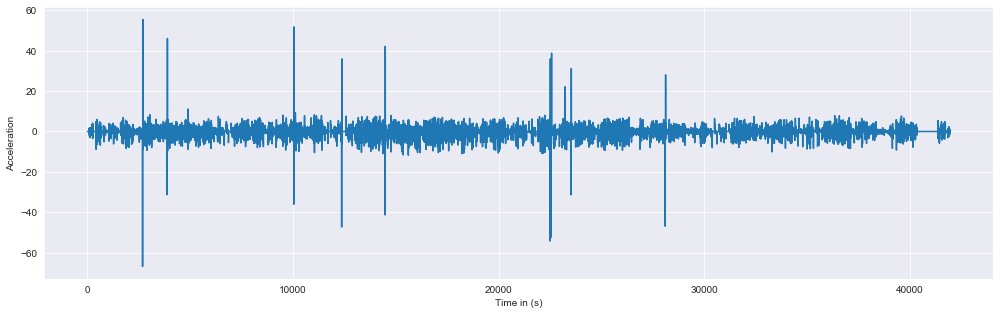

In [5]:
plt.figure(figsize=(17,5))
plt.plot(full_data['accel'])
plt.ylabel("Acceleration")
plt.xlabel("Time in (s)")
plt.show()

### 1.3 Summary statistics of acceleration

In [6]:
full_data['accel'].describe().round(2)

count    41922.00
mean         0.00
std          1.99
min        -66.76
25%         -0.54
50%          0.00
75%          0.68
max         55.48
Name: accel, dtype: float64

### 1.4 Distribution of Acceleration

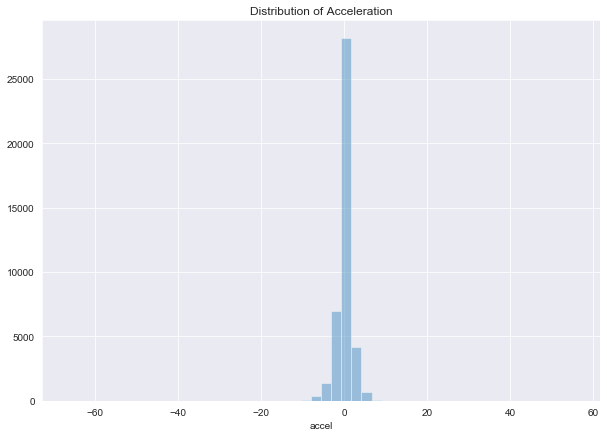

In [7]:
plt.figure(figsize=(10,7))
sns.distplot(full_data['accel'].dropna(), kde=False)
plt.title("Distribution of Acceleration")
plt.show()

### 1.5 Check for Outliers

#### 1.5.1 Skewness & Kurtosis

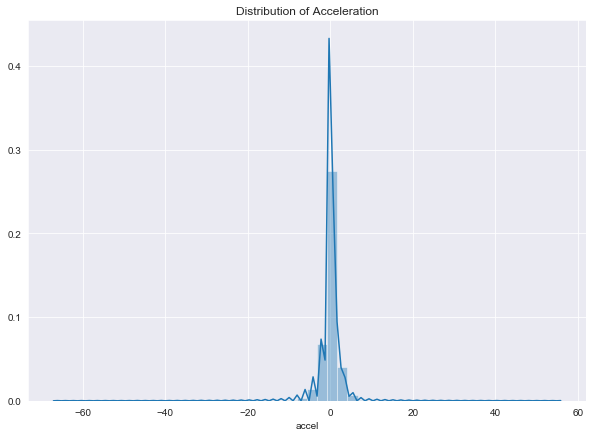

In [8]:
plt.figure(figsize=(10,7))
sns.distplot(full_data['accel'].dropna())
plt.title("Distribution of Acceleration")
plt.show()

In [9]:
print("Skewness: %f" % full_data['accel'].dropna().skew())
print("Kurtosis: %f" % full_data['accel'].dropna().kurt())

Skewness: -1.320317
Kurtosis: 130.459617


**Acceleration distribution has both a positive tail and negative tail. However, the negative tail is longer than the positive tail. So the distribution is negative skewed, and the data are heavy-tailed or profusion of outliers.**

There are two regions where the data has low probability to appear: 

     one on the right side of the distribution, another one on the left.
     
**Kurtosis is all about the tails of the distribution — not the peakedness or flatness. It is used to describe the extreme values in one versus the other tail. It is actually the measure of outliers present in the distribution.**
    
     High kurtosis in a data set is an indicator that data has heavy tails or outliers. 

#### 1.5.2 Violin plot
Typically a violin plot includes all the data that is in a box plot, a marker for the median of the data.

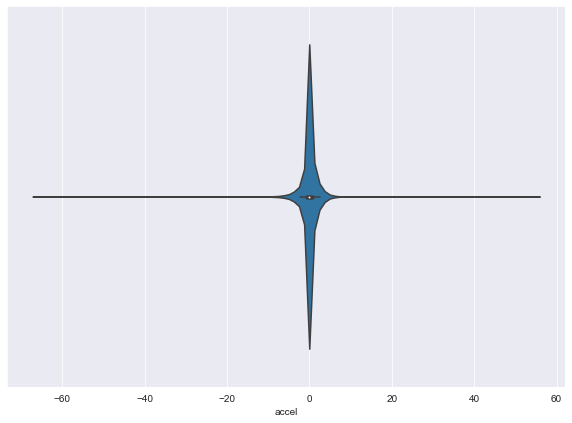

In [10]:
plt.figure(figsize=(10,7))
sns.violinplot(x=full_data["accel"])
plt.show()

#### 1.5.3 Box plot
To get a better idea of outliers we may like to look at a box plot as well.The box in box plot shows the quartiles of the dataset, while the whiskers shows the rest of the distribution.

Whiskers do not show the points that are determined to be outliers.
Outliers are detected by a method which is a function of the interquartile range.
In statistics the interquartile range, also known as mid spread or middle 50%, is a measure of statistical dispersion, which is equal to the difference between 75th and 25th percentiles.

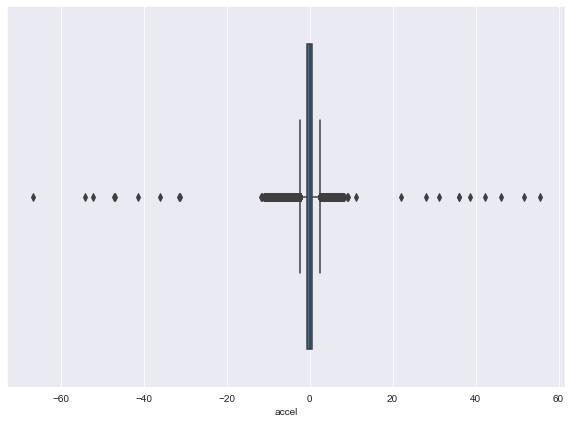

In [11]:
plt.figure(figsize=(10,7))
sns.boxplot(x=full_data["accel"])
plt.show()

# 2. Modelling

## 2.1 Simple rolling window standard deviation(σ)

* The standard deviation of the current window of data points will be processed, denoted by *std_w*, is examined.

* If *std_w* is greater than a  threshold,  denoted  by *std_r* then  the  Self  Triggered  Pattern Matching  Algorithm  is  automatically  executed.

In [12]:
def Moving_std(x):
    x = x.dropna()
    std_w  = x.rolling(window=20).std().fillna(0)
    std_r = x.expanding().std().fillna(0)
    df = pd.DataFrame()
    df['std_w'] = std_w
    df['std_r'] = std_r
    df['accel'] = x
    a = df.loc[std_w > (2)*std_r]

    fig = go.Figure()
    fig.add_trace(go.Scatter(x=x.index.values, y=x, mode='lines',name = 'Normal'))
    fig.add_trace(go.Scatter(x=a['accel'].index, y=a['accel'], mode='markers',name = 'Abnormal'))



    fig.update_layout(title='Accident prone locations',
                       xaxis_title='Time (s)',
                       yaxis_title='Acceleration (km/s^2)')

    return fig.show()

Moving_std(full_data['accel'])

## 2.2 Anomaly finding using Matrix Profile

The Matrix Profile has two primary components; a distance profile and profile index.

The distance profile is a vector of minimum Z-Normalized Euclidean Distances. The profile index contains the index of its first nearest-neighbor. 

    In other words, it is the location of its most similar sub-sequence.

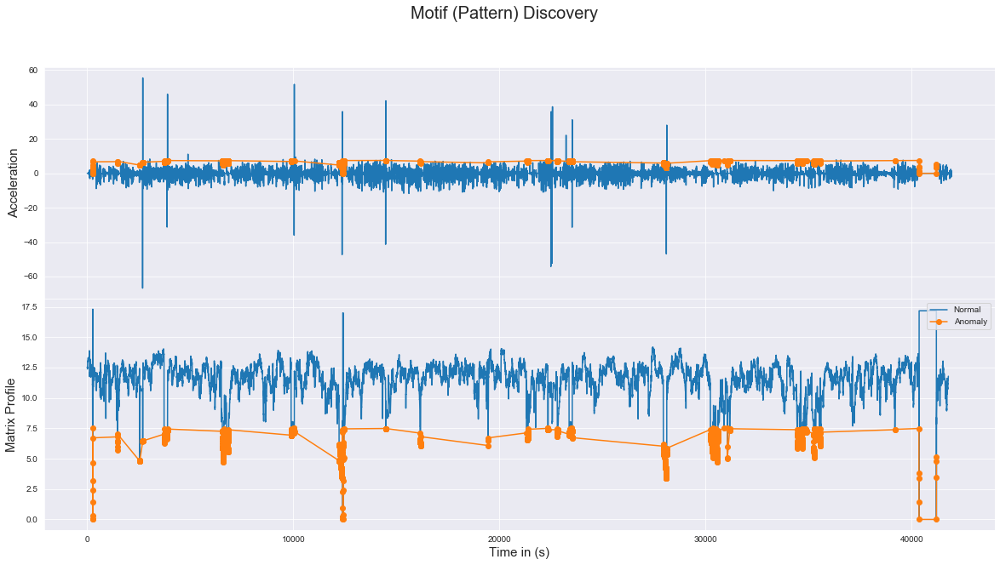

In [13]:
def Matrix_profile(x):
    mp = stumpy.stumped(dask_client, x.dropna().values, m=150) 

    fig, axs = plt.subplots(2, sharex=True, gridspec_kw={'hspace': 0},figsize=(20,10))
    plt.suptitle('Motif (Pattern) Discovery', fontsize='20')


    axs[0].plot(x.dropna().values, label="Normal")
    plt.legend(["Normal","Anomaly"],loc="upper right")
    mf = pd.DataFrame()
    mf['accel'] = x.dropna()
    mf['mp'] = pd.Series(mp[:, 0])
    mf.dropna(inplace=True)
    outliers = mf['mp'][mf['mp']<=7.5]
    axs[0].plot( outliers,marker='o', label="Anomaly")


    axs[0].set_ylabel('Acceleration', fontsize='15')
    # rect = Rectangle((643, 0), m, 40, facecolor='lightgreen')
    # axs[0].add_patch(rect)
    # rect = Rectangle((8724, 0), m, 40, facecolor='lightgreen')
    # axs[0].add_patch(rect)
    axs[1].set_xlabel('Time in (s)', fontsize ='15')
    axs[1].set_ylabel('Matrix Profile', fontsize='15')
    # axs[1].axvline(x=643, linestyle="dashed")
    # axs[1].axvline(x=8724, linestyle="dashed")
    axs[1].plot(mp[:, 0])
    m = pd.Series(mp[:, 0])
    axs[1].plot(m[m<=7.5].index , m[m<=7.5],marker='o')
    plt.legend(["Normal","Anomaly"],loc="upper right")
    
    return plt.show()

Matrix_profile(full_data['accel'])

## 2.3 Unusual driving events searching(Sub-sequence Matching)

In [14]:
def similar_ts(ts, subseq, w_size, k):
    q = np.array(subseq)
    ts = np.array(ts)
    dist = mts.mass3(ts, q, w_size)
    top_motif = mts.top_k_motifs(dist, k, exclusion_zone=10)
    return top_motif

In [15]:
x= full_data['accel'].dropna()

**Plotting Unusual driving events :**

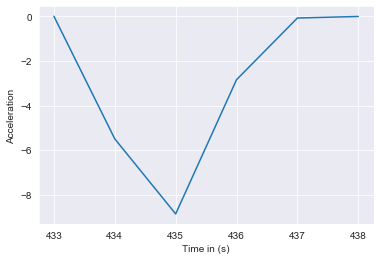

[20930, 16812, 12778, 11712, 432, 28811, 3268]

In [16]:
plt.plot(x[432:438])
plt.ylabel("Acceleration")
plt.xlabel("Time in (s)")
plt.show()
m1 = similar_ts(x, x[432:438], w_size=10, k=7)
m1

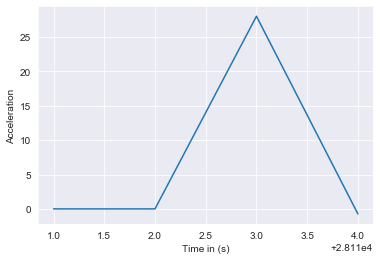

[10817, 40199, 28110, 2693, 41728, 10061, 23526]

In [17]:
plt.plot(x[28110:28114])
plt.ylabel("Acceleration")
plt.xlabel("Time in (s)")
plt.show()
m2 = similar_ts(x, x[28110:28114], w_size=10, k=7)
m2

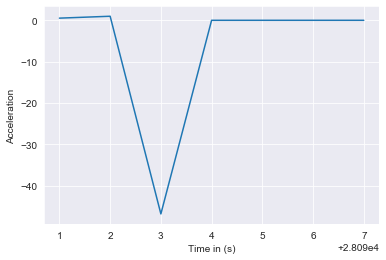

[28090, 23206, 22488, 23518, 12361, 2684, 22548]

In [18]:
plt.plot(x[28090:28097])
plt.ylabel("Acceleration")
plt.xlabel("Time in (s)")
plt.show()
m3 = similar_ts(x, x[28090:28097], w_size=10, k=7)
m3

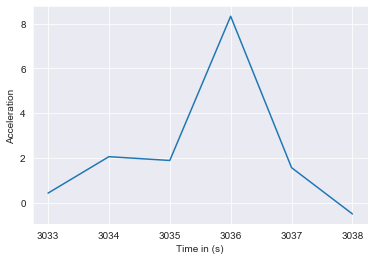

[3033, 25099, 5555, 17243, 31340, 26900, 26436]

In [19]:
plt.plot(x[3032:3038])
plt.ylabel("Acceleration")
plt.xlabel("Time in (s)")
plt.show()
m4= similar_ts(x, x[3033:3039], w_size=10, k=7)
m4

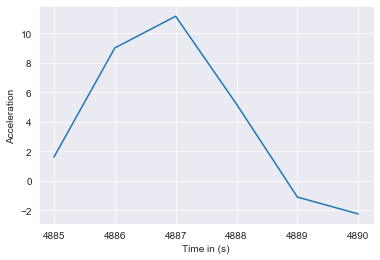

[35124, 4884, 25521, 1789, 11968, 29104, 4132]

In [20]:
plt.plot(x[4884:4890])
plt.ylabel("Acceleration")
plt.xlabel("Time in (s)")
plt.show()
m5= similar_ts(x, x[4884:4889], w_size=10, k=7)
m5

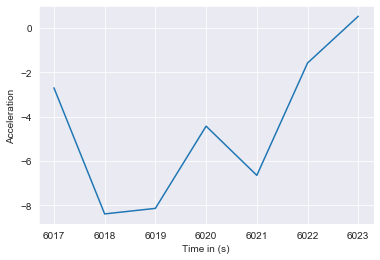

[7803, 7236, 6016, 24414, 12106, 2173, 40257]

In [21]:
plt.plot(x[6016:6023])
plt.ylabel("Acceleration")
plt.xlabel("Time in (s)")
plt.show()
m6= similar_ts(x, x[6016:6023], w_size=10, k=7)
m6

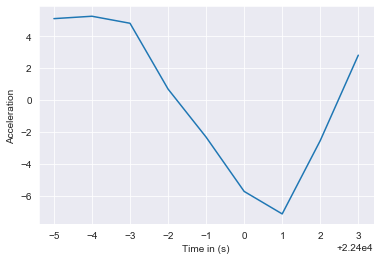

[22394, 34993, 28249, 22944, 28718, 34867, 41670]

In [22]:
plt.plot(x[22394:22403])
plt.ylabel("Acceleration")
plt.xlabel("Time in (s)")
plt.show()
m7= similar_ts(x, x[22394:22403], w_size=12, k=7)
m7

In [23]:
top_motifs = m1+m2+m3+m4+m5+m6+m7

In [24]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=full_data['accel'].index, y=full_data['accel'], mode='lines',name = 'Normal'))
fig.add_trace(go.Scatter(x=full_data.loc[top_motifs,'accel'].index, y=full_data.loc[top_motifs,'accel'], mode='markers',name = 'Abnormal'))



fig.update_layout(title='Accident prone locations',
                   xaxis_title='Time (s)',
                   yaxis_title='Acceleration (km/s^2)')

fig.show()

## 2.5 Anomaly detection using Isolation forest

Isolation forest is a machine learning algorithm for anomaly detection.
It's an unsupervised learning algorithm that identifies anomaly by isolating outliers in the data.

     Isolation Forest is based on the Decision Tree algorithm. It isolates the outliers by randomly selecting a feature from the given set of features and then randomly selecting a split value between the max and min values of that     feature. This random partitioning of features will produce shorter paths in trees for the anomalous data points, thus distinguishing them from the rest of the data.

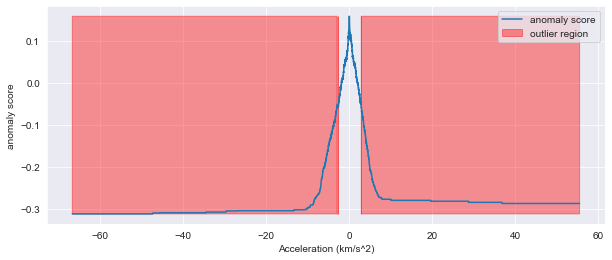

In [25]:
isolation_forest = IsolationForest(n_estimators=100)
isolation_forest.fit(full_data['accel'].dropna().values.reshape(-1, 1))
xx = np.linspace(full_data['accel'].dropna().min(), full_data['accel'].dropna().max(), len(full_data['accel'].dropna())).reshape(-1,1)
anomaly_score = isolation_forest.decision_function(xx)
outlier = isolation_forest.predict(xx)
plt.figure(figsize=(10,4))
plt.plot(xx, anomaly_score, label='anomaly score')
plt.fill_between(xx.T[0], np.min(anomaly_score), np.max(anomaly_score), 
                 where=outlier==-1, color='r', 
                 alpha=.4, label='outlier region')
plt.legend()
plt.ylabel('anomaly score')
plt.xlabel('Acceleration (km/s^2)')
plt.show();

In [26]:
def Isolation_Forest_accel(data, full_data):
    data = data.dropna()
    scaler = StandardScaler()
    np_scaled = scaler.fit_transform(data)
    data = pd.DataFrame(np_scaled)
    # train isolation forest
    model =  IsolationForest(contamination=0.005,random_state=13)
    model.fit(data) 
    full_data['anomaly2'] = pd.Series(model.predict(data))
    a = full_data.loc[full_data['anomaly2'] == -1, ['GPS Latitude - TCU','GPS Longitude - TCU','accel']] #anomaly
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=full_data.index.values, y=full_data['accel'], mode='lines',name = 'Normal'))
    fig.add_trace(go.Scatter(x=a.index, y=a['accel'], mode='markers',name = 'Anomaly'))


    fig.update_layout(title='Accident prone locations',
                       xaxis_title='Time (s)',
                       yaxis_title='Acceleration (km/s^2)')   
    return a , fig.show()

In [27]:
a = Isolation_Forest_accel(full_data[['accel']], full_data)[0]

### 2.2.1 Demo result on map

In [28]:
shaz13_custom_style = "open-street-map"
#set the geo=spatial data
data = [go.Scattermapbox(
            lat= full_data['GPS Latitude - TCU'] ,
            lon= full_data['GPS Longitude - TCU'],
            mode='markers', name='Vehicle Route',
            marker=dict(
                size= 4,
                color = 'blue',
                opacity = 1,
            ),
          ),
        go.Scattermapbox(
            lat= a['GPS Latitude - TCU'] ,
            lon= a['GPS Longitude - TCU'],
            mode='markers', name='Accident prone location',
            marker=dict(
                size= 7,
                color = 'red',
                opacity = .6,
            ),
          )
    ]
#set the layout to plot
layout = go.Layout(autosize=False,
                   mapbox= dict(accesstoken="pk.eyJ1IjoieW1heWFuazk3IiwiYSI6ImNrNXFicXdkcjAwcnIzbXBiZjFjeXZwNjMifQ.soEa1tMJAXlsFuQv1f1v0g",
                                bearing=10,
                                pitch=60,
                                zoom=13,
                                center= dict(lat=28.574890000000003,
                                             lon=77.14829),
                                style=shaz13_custom_style),
                    width=900,
                    height=600, 
                    title = "Accident Prone Areas")

In [29]:
fig = dict(data=data, layout=layout)
py.iplot(fig,'map.html',)

# Doing above approaches for derived variable 'Jerk' :

### Data Visualization

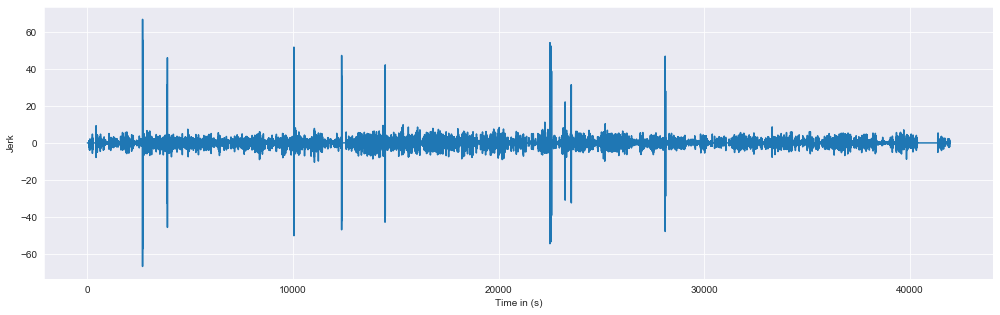

In [30]:
full_data['jerk']=(full_data['accel']-full_data['accel'].shift(1))

plt.figure(figsize=(17,5))
plt.plot(full_data['jerk'])
plt.ylabel("Jerk")
plt.xlabel("Time in (s)")
plt.show()

### Isolation tree

In [31]:
def Isolation_Forest_jerk(data, full_data):
    data = data.dropna()
    scaler = StandardScaler()
    np_scaled = scaler.fit_transform(data)
    data = pd.DataFrame(np_scaled)
    # train isolation forest
    model =  IsolationForest(contamination=0.005,random_state=13)
    model.fit(data) 
    full_data['anomaly2'] = pd.Series(model.predict(data))
    a = full_data.loc[full_data['anomaly2'] == -1, ['GPS Latitude - TCU','GPS Longitude - TCU','jerk']] #anomaly
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=full_data.index.values, y=full_data['jerk'], mode='lines',name = 'Normal'))
    fig.add_trace(go.Scatter(x=a.index, y=a['jerk'], mode='markers',name = 'Anomaly'))


    fig.update_layout(title='Accident prone locations',
                       xaxis_title='Time (s)',
                       yaxis_title='Jerk (km/s^3)')   
    return a , fig.show()

In [32]:
aj = Isolation_Forest_jerk(full_data[['jerk']], full_data)[0]

In [1]:
shaz13_custom_style = "open-street-map"
#set the geo=spatial data
data = [go.Scattermapbox(
            lat= full_data['GPS Latitude - TCU'] ,
            lon= full_data['GPS Longitude - TCU'],
            mode='markers', name='Vehicle Route',
            marker=dict(
                size= 4,
                color = 'blue',
                opacity = 1,
            ),
          ),
        go.Scattermapbox(
            lat= aj['GPS Latitude - TCU'] ,
            lon= aj['GPS Longitude - TCU'],
            mode='markers', name='Accident prone location',
            marker=dict(
                size= 7,
                color = 'red',
                opacity = .6,
            ),
          )
    ]
#set the layout to plot
layout = go.Layout(autosize=False,
                   mapbox= dict(accesstoken="pk.eyJ1IjoieW1heWFuazk3IiwiYSI6ImNrNXFicXdkcjAwcnIzbXBiZjFjeXZwNjMifQ.soEa1tMJAXlsFuQv1f1v0g",
                                bearing=10,
                                pitch=60,
                                zoom=13,
                                center= dict(lat=28.574890000000003,
                                             lon=77.14829),
                                style=shaz13_custom_style),
                    width=900,
                    height=600, 
                    title = "Accident Prone Areas")

NameError: name 'go' is not defined

In [34]:
fig = dict(data=data, layout=layout)
py.iplot(fig,'map.html',)

In [35]:
aj = aj.drop('jerk',1)
a = a.drop('accel',1)
c = pd.concat([aj,a]).drop_duplicates(keep=False)

### Compare Jerk and Acceleration used as anomaly detection 

In [36]:
print('Anomaly picked in acceleration as a variable are ', len(a))
print('Anomaly picked in jerk as a variable are ', len(aj))
print('Common anomaly picked are ', round(((len(aj)+len(a))-len(c))/2))

Anomaly picked in acceleration as a variable are  204
Anomaly picked in jerk as a variable are  210
Common anomaly picked are  68
